In [1]:
# !pip install diffusers transformers jax jaxlib opencv-contrib-python controlnet_aux pytorch_lightning instafilter git+https://github.com/huggingface/accelerate.git

In [2]:
# !pip install -U xformers --index-url https://download.pytorch.org/whl/cu118

In [18]:
from torchvision.models.segmentation import deeplabv3_resnet101

In [1]:
from argparse import Namespace
import accelerate
import argparse
import itertools
import math
import os
from contextlib import nullcontext
import random

import numpy as np
import torch
import torch.nn.functional as F
import torch.utils.checkpoint
from torch.utils.data import Dataset

import PIL
from accelerate import Accelerator
from accelerate.logging import get_logger
from accelerate.utils import set_seed
from diffusers import AutoencoderKL, DDIMScheduler, DDPMScheduler, DPMSolverMultistepScheduler, PNDMScheduler, \
    StableDiffusionPipeline, UNet2DConditionModel
from diffusers.optimization import get_scheduler
from diffusers.pipelines.stable_diffusion import StableDiffusionSafetyChecker
from PIL import Image
from torchvision import transforms
from tqdm.auto import tqdm
from transformers import CLIPFeatureExtractor, CLIPTextModel, CLIPTokenizer

import bitsandbytes as bnb

from controlnet_aux import OpenposeDetector
from diffusers import AutoencoderKL, ControlNetModel, StableDiffusionXLControlNetPipeline
from diffusers.utils import load_image
from instafilter import Instafilter
import gc
import matplotlib.pyplot as plt
import torch

from PIL import Image
from pytorch_lightning import seed_everything
from diffusers.utils import load_image
from diffusers import (
    DiffusionPipeline,
    ControlNetModel,
)
from diffusers.pipelines.controlnet.multicontrolnet import MultiControlNetModel
from diffusers.schedulers import (
    EulerAncestralDiscreteScheduler, UniPCMultistepScheduler
)

import transformers
from controlnet_aux import HEDdetector
import numpy as np


%load_ext autoreload
%autoreload 2
%matplotlib inline


def image_grid(imgs, rows, cols):
    assert len(imgs) == rows * cols

    w, h = imgs[0].size
    grid = Image.new("RGB", size=(cols * w, rows * h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i % cols * w, i // cols * h))
        
    return grid

from torch.utils.tensorboard import SummaryWriter

writer = SummaryWriter()

# DeepLab

In [ ]:
orig_grad = load_image('StacyGrad.jpg').convert('RGBA')

In [ ]:
orig_grad

In [ ]:
model = Instafilter("Hudson", device='cpu')
new_image = model("StacyTemple.jpeg")
plt.imshow(new_image[..., ::-1])
# cv2.imwrite("modified_image.jpg", new_image)

In [3]:
# image_ref = load_image("http://metaloft.com/images/cat-striped-768x768.jpg").convert("RGBA")
# image_con = load_image("http://metaloft.com/images/cat-orange-768x768.jpg").convert("RGB")
image_ref = load_image('StacyGrad.jpg').convert("RGBA")
image_con = load_image('StacyTemple.jpg').convert("RGBA")

# Adding VAE destroys portraits
# vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16, use_safetensors=True)

# controlnet_hed = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-hed", torch_dtype=torch.float16)
# controlnet_depth = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-depth", torch_dtype=torch.float16)
controlnet_pose = ControlNetModel.from_pretrained(
    'lllyasviel/control_v11p_sd15_openpose', 
    # 'thibaud/controlnet-openpose-sdxl-1.0',
    torch_dtype=torch.float16
)

openpose_model = OpenposeDetector.from_pretrained("lllyasviel/ControlNet")
image_pose = openpose_model(image_con, hand_and_face=True).resize((768, 768))

# hed_model = HEDdetector.from_pretrained(
#     'lllyasviel/Annotators'
#     # 'lllyasviel/ControlNet'
# )
# depth_model = transformers.pipeline(task="depth-estimation", model="Intel/dpt-large")

# image_depth = depth_model(image_con)['depth']
# image_depth = np.array(image_depth)
# image_depth = image_depth[:, :, None]
# image_depth = np.concatenate([image_depth, image_depth, image_depth], axis=2)
# image_depth = Image.fromarray(image_depth)
# image_depth = image_depth.resize((768, 768))
# image_depth.save('depth.png')

# image_hed = hed_model(image_con)
# image_hed = image_hed.resize((768, 768))
# image_hed.save('hed.png')

In [17]:
# sd_model = "stabilityai/stable-diffusion-xl-base-1.0"
sd_model = "SG161222/Realistic_Vision_V2.0"
# sd_model = "runwayml/stable-diffusion-v1-5"

# Also known as sampler
# scheduler = UniPCMultistepScheduler.from_pretrained(sd_model, subfolder="scheduler", use_karras_sigmas=True)
scheduler = EulerAncestralDiscreteScheduler.from_pretrained(sd_model, subfolder="scheduler", use_karras_sigmas=True)

pipe = (
    DiffusionPipeline.from_pretrained(
    # StableDiffusionXLControlNetPipeline.from_pretrained(
        sd_model,
        # Must use the controlnet_reference pipeline
        # otherwise results are drastically diff from input reference img
        custom_pipeline="stable_diffusion_controlnet_reference",
        torch_dtype=torch.float16,
        controlnet=MultiControlNetModel([
            controlnet_pose
            # controlnet_depth, 
            # controlnet_hed
        ]),
        # vae=vae,
        use_safetensors=True,
        local_files_only=True,
        # Github branch
        revision="main",
        scheduler=scheduler
    )
)
# pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)
pipe.enable_xformers_memory_efficient_attention()
pipe.enable_model_cpu_offload()

generator = torch.Generator(device="cpu").manual_seed(0)

/opt/conda/lib/python3.10/site-packages/huggingface_hub/file_download.py:669: FutureWarning: 'cached_download' is the legacy way to download files from the HF hub, please consider upgrading to 'hf_hub_download'
  warnings.warn(


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [101]:
seed_everything(0)
res_imgs = pipe(
    # prompt="1lady, masterpiece, best quality, highres, (photorealistic:1.4)",
    prompt="",
    negative_prompt=", ".join([
        "nsfw", 
        "monochrome", 
        "lowres", "worst quality", "low quality", "normal quality", "blurry",
        "bad anatomy", "bad hands", "missing fingers", "extra legs", "extra hands", "bad face",
        "text", 
        "error", 
        "extra digit", "fewer digits", 
        "cropped", 
        "jpeg artifacts",
        "signature", "watermark", "username",
    ]),
    image=[
        image_pose
        # image_depth, 
        # image_hed
    ],
    num_images_per_prompt=3,
    width=768, 
    height=768, 
    generator=generator,
    # Also known as CFG, classifier-free guidance scale
    guidance_scale=3.0, 
    num_inference_steps=50,
    ref_image=image_ref, 
    reference_attn=True, 
    reference_adain=True, 
    style_fidelity=1.0,
    guess_mode=True,
    controlnet_conditioning_scale=[1.0, 0.8]
).images

# summary = Image.new("RGB", (768*3, 768))

# for i in range(3):
#     summary.paste(Image.open(f"output-{i}.png"), (768*i,0))
    
# summary.save("summary.png")

Seed set to 0


  0%|          | 0/50 [00:00<?, ?it/s]

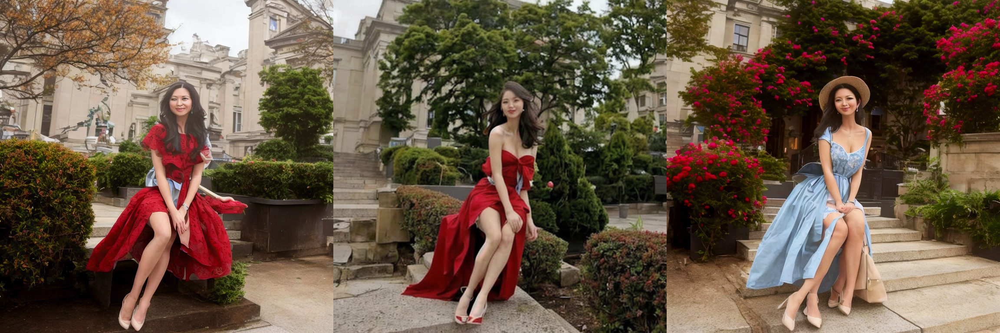

In [44]:
image_grid(res_imgs, 1, 3)

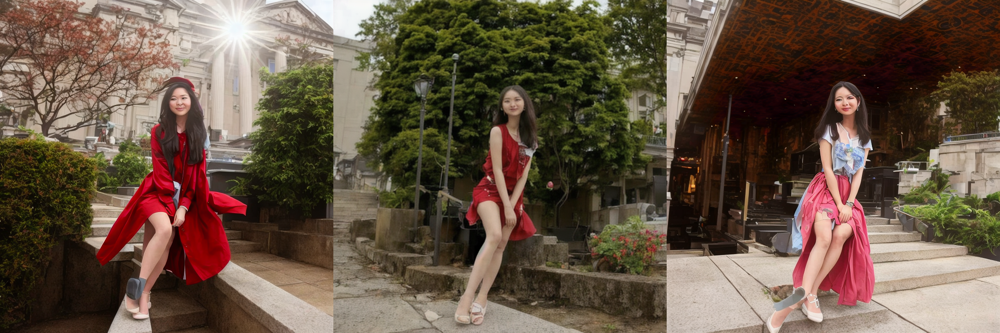

In [76]:
image_grid(res_imgs, 1, 3)

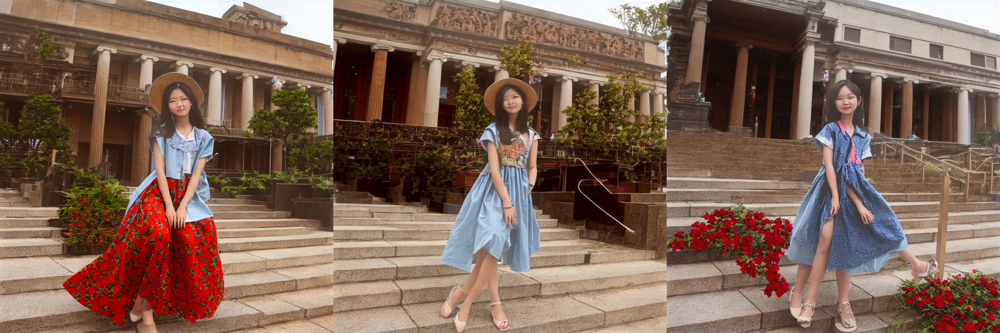

In [80]:
image_grid(res_imgs, 1, 3)

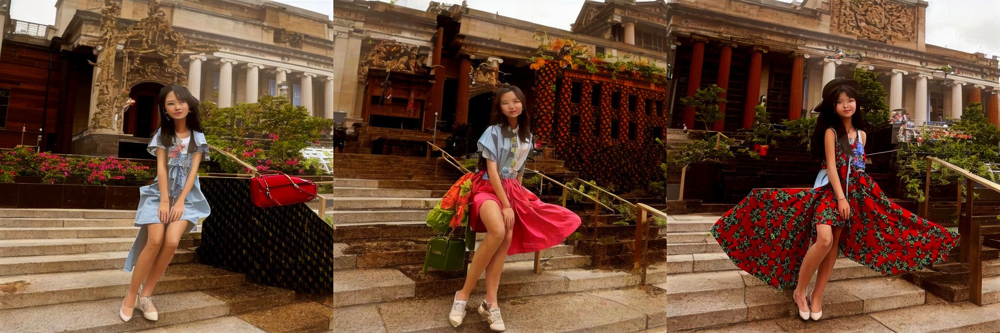

In [84]:
image_grid(res_imgs, 1, 3)

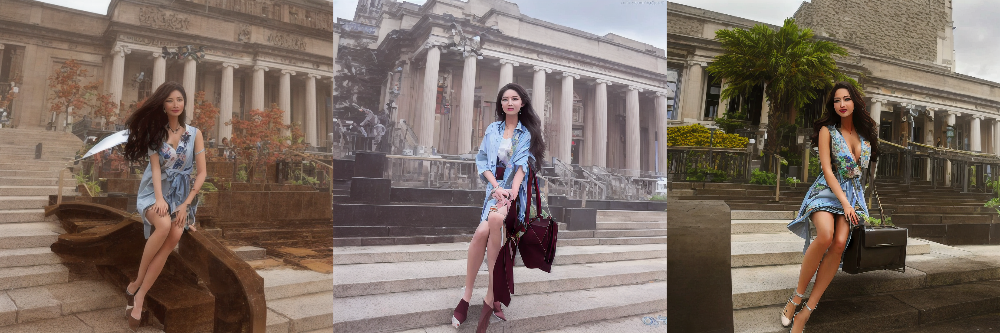

In [95]:
image_grid(res_imgs, 1, 3)

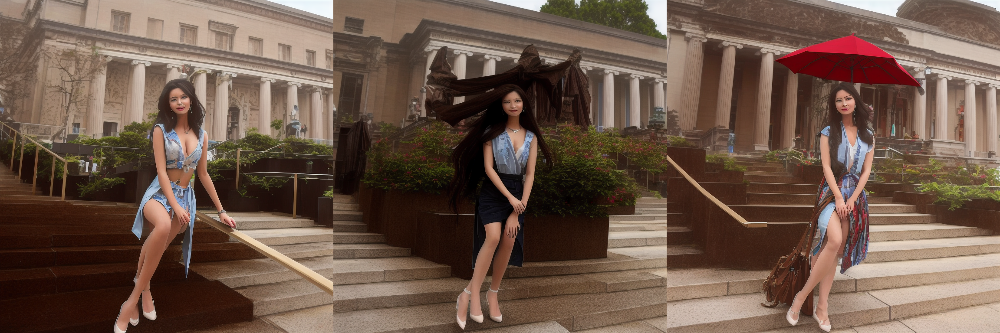

In [102]:
image_grid(res_imgs, 1, 3)

# Dreambooth

In [4]:
save_path = "./stacy_concept"
# pretrained_model_name_or_path = "stabilityai/stable-diffusion-2"
pretrained_model_name_or_path = 'runwayml/stable-diffusion-v1-5'
instance_prompt = "hndnmnv woman"
prior_preservation = True
prior_preservation_class_prompt = "a photo of a woman"

num_class_images = 23
sample_batch_size = 2
prior_loss_weight = 1
prior_preservation_class_folder = "./class_images"
class_data_root=prior_preservation_class_folder
class_prompt=prior_preservation_class_prompt

In [6]:
from pathlib import Path
from torchvision import transforms

class DreamBoothDataset(Dataset):
    def __init__(
        self,
        instance_data_root,
        instance_prompt,
        tokenizer,
        class_data_root=None,
        class_prompt=None,
        size=512,
        center_crop=False,
    ):
        self.size = size
        self.center_crop = center_crop
        self.tokenizer = tokenizer

        self.instance_data_root = Path(instance_data_root)
        if not self.instance_data_root.exists():
            raise ValueError("Instance images root doesn't exists.")

        self.instance_images_path = list(Path(instance_data_root).iterdir())
        self.num_instance_images = len(self.instance_images_path)
        self.instance_prompt = instance_prompt
        self._length = self.num_instance_images

        if class_data_root is not None:
            self.class_data_root = Path(class_data_root)
            self.class_data_root.mkdir(parents=True, exist_ok=True)
            self.class_images_path = list(Path(class_data_root).iterdir())
            self.num_class_images = len(self.class_images_path)
            self._length = max(self.num_class_images, self.num_instance_images)
            self.class_prompt = class_prompt
        else:
            self.class_data_root = None

        self.image_transforms = transforms.Compose(
            [
                transforms.Resize(size, interpolation=transforms.InterpolationMode.BILINEAR),
                transforms.CenterCrop(size) if center_crop else transforms.RandomCrop(size),
                transforms.ToTensor(),
                transforms.Normalize([0.5], [0.5]),
            ]
        )

    def __len__(self):
        return self._length

    def __getitem__(self, index):
        example = {}
        instance_image = Image.open(self.instance_images_path[index % self.num_instance_images])
        
        if not instance_image.mode == "RGB":
            instance_image = instance_image.convert("RGB")
            
        instance_image.thumbnail((768, 768))
        example["instance_images"] = self.image_transforms(instance_image)
        example["instance_prompt_ids"] = self.tokenizer(
            self.instance_prompt,
            padding="do_not_pad",
            truncation=True,
            max_length=self.tokenizer.model_max_length,
        ).input_ids

        if self.class_data_root:
            class_image = Image.open(self.class_images_path[index % self.num_class_images])
            
            if not class_image.mode == "RGB":
                class_image = class_image.convert("RGB")
                
            class_image.thumbnail((768, 768))
            example["class_images"] = self.image_transforms(class_image)
            example["class_prompt_ids"] = self.tokenizer(
                self.class_prompt,
                padding="do_not_pad",
                truncation=True,
                max_length=self.tokenizer.model_max_length,
            ).input_ids
        
        return example


class PromptDataset(Dataset):
    def __init__(self, prompt, num_samples):
        self.prompt = prompt
        self.num_samples = num_samples

    def __len__(self):
        return self.num_samples

    def __getitem__(self, index):
        example = {}
        example["prompt"] = self.prompt
        example["index"] = index
        return example
    
if(prior_preservation):
    class_images_dir = Path(class_data_root)
    
    if not class_images_dir.exists():
        class_images_dir.mkdir(parents=True)
        
    cur_class_images = len(list(class_images_dir.iterdir()))

    if cur_class_images < num_class_images:
        pipeline = StableDiffusionPipeline.from_pretrained(
            pretrained_model_name_or_path, revision="fp16", torch_dtype=torch.float16
        ).to("cuda")
        pipeline.enable_attention_slicing()
        pipeline.set_progress_bar_config(disable=True)

        num_new_images = num_class_images - cur_class_images
        print(f"Number of class images to sample: {num_new_images}.")

        sample_dataset = PromptDataset(class_prompt, num_new_images)
        sample_dataloader = torch.utils.data.DataLoader(sample_dataset, batch_size=sample_batch_size)

        for example in tqdm(sample_dataloader, desc="Generating class images"):
            images = pipeline(example["prompt"]).images

            for i, image in enumerate(images):
                image.save(class_images_dir / f"{example['index'][i] + cur_class_images}.jpg")
        pipeline = None
        gc.collect()
        del pipeline
        
        with torch.no_grad():
          torch.cuda.empty_cache()
        
text_encoder = CLIPTextModel.from_pretrained(
    pretrained_model_name_or_path, subfolder="text_encoder"
)
vae = AutoencoderKL.from_pretrained(
    pretrained_model_name_or_path, subfolder="vae"
)
unet = UNet2DConditionModel.from_pretrained(
    pretrained_model_name_or_path, subfolder="unet"
)
tokenizer = CLIPTokenizer.from_pretrained(
    pretrained_model_name_or_path,
    subfolder="tokenizer",
)

args = Namespace(
    pretrained_model_name_or_path=pretrained_model_name_or_path,
    resolution=vae.sample_size,
    center_crop=True,
    train_text_encoder=False,
    instance_data_dir=save_path,
    instance_prompt=instance_prompt,
    learning_rate=1e-06,
    max_train_steps=1200,
    save_steps=200,
    train_batch_size=1, # set to 1 if using prior preservation, otherwise 2
    gradient_accumulation_steps=2,
    max_grad_norm=1.0,
    mixed_precision="fp16", # set to "fp16" for mixed-precision training.
    gradient_checkpointing=True, # set this to True to lower the memory usage.
    use_8bit_adam=True, # use 8bit optimizer from bitsandbytes
    seed=0,
    with_prior_preservation=prior_preservation, 
    prior_loss_weight=prior_loss_weight,
    sample_batch_size=2,
    class_data_dir=prior_preservation_class_folder, 
    class_prompt=prior_preservation_class_prompt, 
    num_class_images=num_class_images, 
    lr_scheduler="constant",
    lr_warmup_steps=100,
    output_dir="dreambooth-concept",
)

def training_function(text_encoder, vae, unet):
    logger = get_logger(__name__)

    set_seed(args.seed)

    accelerator = Accelerator(
        gradient_accumulation_steps=args.gradient_accumulation_steps,
        mixed_precision=args.mixed_precision,
    )

    # Currently, it's not possible to do gradient accumulation when training two models with accelerate.accumulate
    # This will be enabled soon in accelerate. For now, we don't allow gradient accumulation when training two models.
    # TODO (patil-suraj): Remove this check when gradient accumulation with two models is enabled in accelerate.
    if args.train_text_encoder and args.gradient_accumulation_steps > 1 and accelerator.num_processes > 1:
        raise ValueError(
            "Gradient accumulation is not supported when training the text encoder in distributed training. "
            "Please set gradient_accumulation_steps to 1. This feature will be supported in the future."
        )

    vae.requires_grad_(False)
    
    if not args.train_text_encoder:
        text_encoder.requires_grad_(False)

    if args.gradient_checkpointing:
        unet.enable_gradient_checkpointing()
        if args.train_text_encoder:
            text_encoder.gradient_checkpointing_enable()

    # Use 8-bit Adam for lower memory usage or to fine-tune the model in 16GB GPUs
    if args.use_8bit_adam:
        optimizer_class = bnb.optim.AdamW8bit
    else:
        optimizer_class = torch.optim.AdamW
    
    params_to_optimize = (
        itertools.chain(unet.parameters(), text_encoder.parameters()) if args.train_text_encoder else unet.parameters()
    )

    optimizer = optimizer_class(
        params_to_optimize,
        lr=args.learning_rate,
    )

    # noise_scheduler = DDPMScheduler.from_config(args.pretrained_model_name_or_path, subfolder="scheduler")
    noise_scheduler = DDIMScheduler.from_config(args.pretrained_model_name_or_path, subfolder="scheduler")
    
    train_dataset = DreamBoothDataset(
        instance_data_root=args.instance_data_dir,
        instance_prompt=args.instance_prompt,
        class_data_root=args.class_data_dir if args.with_prior_preservation else None,
        class_prompt=args.class_prompt,
        tokenizer=tokenizer,
        size=args.resolution,
        center_crop=args.center_crop,
    )

    def collate_fn(examples):
        input_ids = [example["instance_prompt_ids"] for example in examples]
        pixel_values = [example["instance_images"] for example in examples]

        # concat class and instance examples for prior preservation
        if args.with_prior_preservation:
            input_ids += [example["class_prompt_ids"] for example in examples]
            pixel_values += [example["class_images"] for example in examples]

        pixel_values = torch.stack(pixel_values)
        pixel_values = pixel_values.to(memory_format=torch.contiguous_format).float()

        input_ids = tokenizer.pad(
            {"input_ids": input_ids},
            padding="max_length",
            return_tensors="pt",
            max_length=tokenizer.model_max_length
        ).input_ids

        batch = {
            "input_ids": input_ids,
            "pixel_values": pixel_values,
        }
        return batch
    
    train_dataloader = torch.utils.data.DataLoader(
        train_dataset, batch_size=args.train_batch_size, shuffle=True, collate_fn=collate_fn
    )

    lr_scheduler = get_scheduler(
        args.lr_scheduler,
        optimizer=optimizer,
        num_warmup_steps=args.lr_warmup_steps * args.gradient_accumulation_steps,
        num_training_steps=args.max_train_steps * args.gradient_accumulation_steps,
    )

    if args.train_text_encoder:
        unet, text_encoder, optimizer, train_dataloader, lr_scheduler = accelerator.prepare(
            unet, text_encoder, optimizer, train_dataloader, lr_scheduler
        )
    else:
        unet, optimizer, train_dataloader, lr_scheduler = accelerator.prepare(
            unet, optimizer, train_dataloader, lr_scheduler
        )

    weight_dtype = torch.float32
    
    if accelerator.mixed_precision == "fp16":
        weight_dtype = torch.float16
    elif accelerator.mixed_precision == "bf16":
        weight_dtype = torch.bfloat16
    
    # Move text_encode and vae to gpu.
    # For mixed precision training we cast the text_encoder and vae weights to half-precision
    # as these models are only used for inference, keeping weights in full precision is not required.
    vae.to(accelerator.device, dtype=weight_dtype)
    vae.decoder.to("cpu")
    if not args.train_text_encoder:
        text_encoder.to(accelerator.device, dtype=weight_dtype)
    
    # We need to recalculate our total training steps as the size of the training dataloader may have changed.
    num_update_steps_per_epoch = math.ceil(len(train_dataloader) / args.gradient_accumulation_steps)
    num_train_epochs = math.ceil(args.max_train_steps / num_update_steps_per_epoch)
  
    # Train!
    total_batch_size = args.train_batch_size * accelerator.num_processes * args.gradient_accumulation_steps

    logger.info("***** Running training *****")
    logger.info(f"  Num examples = {len(train_dataset)}")
    logger.info(f"  Instantaneous batch size per device = {args.train_batch_size}")
    logger.info(f"  Total train batch size (w. parallel, distributed & accumulation) = {total_batch_size}")
    logger.info(f"  Gradient Accumulation steps = {args.gradient_accumulation_steps}")
    logger.info(f"  Total optimization steps = {args.max_train_steps}")
    # Only show the progress bar once on each machine.
    progress_bar = tqdm(range(args.max_train_steps), disable=not accelerator.is_local_main_process)
    progress_bar.set_description("Steps")
    global_step = 0

    for epoch in range(num_train_epochs):
        unet.train()
        for step, batch in enumerate(train_dataloader):
            with accelerator.accumulate(unet):
                # Convert images to latent space
                latents = vae.encode(batch["pixel_values"].to(dtype=weight_dtype)).latent_dist.sample()
                latents = latents * 0.18215

                # Sample noise that we'll add to the latents
                noise = torch.randn_like(latents)
                bsz = latents.shape[0]
                # Sample a random timestep for each image
                timesteps = torch.randint(0, noise_scheduler.config.num_train_timesteps, (bsz,), device=latents.device)
                timesteps = timesteps.long()

                # Add noise to the latents according to the noise magnitude at each timestep
                # (this is the forward diffusion process)
                noisy_latents = noise_scheduler.add_noise(latents, noise, timesteps)

                # Get the text embedding for conditioning
                encoder_hidden_states = text_encoder(batch["input_ids"])[0]

                # Predict the noise residual
                noise_pred = unet(noisy_latents, timesteps, encoder_hidden_states).sample

                # Get the target for loss depending on the prediction type
                if noise_scheduler.config.prediction_type == "epsilon":
                    target = noise
                elif noise_scheduler.config.prediction_type == "v_prediction":
                    target = noise_scheduler.get_velocity(latents, noise, timesteps)
                else:
                    raise ValueError(f"Unknown prediction type {noise_scheduler.config.prediction_type}")

                if args.with_prior_preservation:
                    # Chunk the noise and noise_pred into two parts and compute the loss on each part separately.
                    noise_pred, noise_pred_prior = torch.chunk(noise_pred, 2, dim=0)
                    target, target_prior = torch.chunk(target, 2, dim=0)

                    # Compute instance loss
                    loss = F.mse_loss(noise_pred.float(), target.float(), reduction="none").mean([1, 2, 3]).mean()

                    # Compute prior loss
                    prior_loss = F.mse_loss(noise_pred_prior.float(), target_prior.float(), reduction="mean")

                    # Add the prior loss to the instance loss.
                    loss = loss + args.prior_loss_weight * prior_loss
                else:
                    loss = F.mse_loss(noise_pred.float(), target.float(), reduction="mean")

                accelerator.backward(loss)
                
                if accelerator.sync_gradients:
                    params_to_clip = (
                        itertools.chain(unet.parameters(), text_encoder.parameters())
                        if args.train_text_encoder
                        else unet.parameters()
                    )
                    accelerator.clip_grad_norm_(unet.parameters(), args.max_grad_norm)
                optimizer.step()
                optimizer.zero_grad()

            # Checks if the accelerator has performed an optimization step behind the scenes
            if accelerator.sync_gradients:
                progress_bar.update(1)
                global_step += 1

                if global_step % args.save_steps == 0:
                    if accelerator.is_main_process:
                        pipeline = StableDiffusionPipeline.from_pretrained(
                            args.pretrained_model_name_or_path,
                            unet=accelerator.unwrap_model(unet),
                            text_encoder=accelerator.unwrap_model(text_encoder),
                        )
                        save_path = os.path.join(args.output_dir, f"checkpoint-{global_step}")
                        pipeline.save_pretrained(save_path)

            logs = {"loss": loss.detach().item()}
            progress_bar.set_postfix(**logs)

            if global_step >= args.max_train_steps:
                break

        accelerator.wait_for_everyone()
    
    # Create the pipeline using using the trained modules and save it.
    if accelerator.is_main_process:
        pipeline = StableDiffusionPipeline.from_pretrained(
            args.pretrained_model_name_or_path,
            unet=accelerator.unwrap_model(unet),
            text_encoder=accelerator.unwrap_model(text_encoder),
        )
        pipeline.save_pretrained(args.output_dir)
        
accelerate.notebook_launcher(training_function, args=(text_encoder, vae, unet), num_processes=1)

for param in itertools.chain(unet.parameters(), text_encoder.parameters()):
    if param.grad is not None:
        del param.grad  # free some memory
        
    torch.cuda.empty_cache()
    
writer.flush()
writer.close()

/var/tmp/ipykernel_4184/2063008187.py:147: FutureWarning: Accessing config attribute `sample_size` directly via 'AutoencoderKL' object attribute is deprecated. Please access 'sample_size' over 'AutoencoderKL's config object instead, e.g. 'unet.config.sample_size'.
  resolution=vae.sample_size,


Launching training on one GPU.


/opt/conda/lib/python3.10/site-packages/diffusers/configuration_utils.py:244: FutureWarning: It is deprecated to pass a pretrained model name or path to `from_config`.If you were trying to load a scheduler, please use <class 'diffusers.schedulers.scheduling_ddim.DDIMScheduler'>.from_pretrained(...) instead. Otherwise, please make sure to pass a configuration dictionary instead. This functionality will be removed in v1.0.0.
  deprecate("config-passed-as-path", "1.0.0", deprecation_message, standard_warn=False)


KeyboardInterrupt: 

In [7]:
try:
    pipeline
except NameError:
    pipeline = StableDiffusionPipeline.from_pretrained(
        args.output_dir,
        # scheduler = DPMSolverMultistepScheduler.from_pretrained(args.output_dir, subfolder="scheduler"),
        scheduler = DDIMScheduler.from_pretrained(args.output_dir, subfolder="scheduler"),
        torch_dtype=torch.float16,
    ).to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

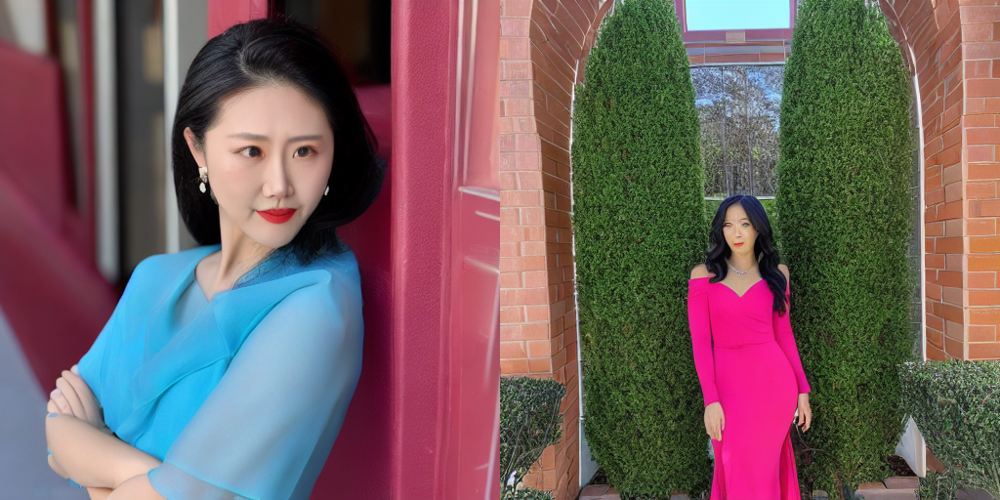

In [8]:
num_samples = 2
num_rows = 1
all_images = [] 
dreambooth_gen = torch.Generator(device="cpu").manual_seed(0)

for _ in range(num_rows):
    images = pipeline(
        prompt="a hndnmnv woman", 
        negative_prompt=", ".join([
            "nsfw", 
            "monochrome", 
            "lowres", "worst quality", "low quality", "normal quality", "blurry",
            "bad anatomy", "bad hands", "missing fingers", "extra legs", "extra hands", "bad face",
            "text", 
            "error", 
            "extra digit", "fewer digits", 
            "cropped", 
            "jpeg artifacts",
            "signature", "watermark", "username",
        ]),
        num_images_per_prompt=num_samples, 
        generator=dreambooth_gen,
        num_inference_steps=25, 
        guidance_scale=7
    ).images
    all_images.extend(images)

grid = image_grid(all_images, num_rows, num_samples)
grid